<a href="https://colab.research.google.com/github/juliacamposn/classificador-de-imagens/blob/main/trabalho_1_ia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import urllib.request
import os
from PIL import Image,ImageStat
import numpy as np
import matplotlib.pyplot as plt
import torchvision
import torch
import torch.nn as nn
from torch.utils.data import  DataLoader
import torchvision.transforms as transforms
from torch import optim
import sklearn.metrics as metrics
import torch.nn.functional as F

#Rede Convolucional

In [2]:
conv1 = nn.Conv2d(in_channels=3,out_channels=6,kernel_size=5,stride=1,padding=0)
conv2 = nn.Conv2d(in_channels=6,out_channels=16,kernel_size=5,stride=1,padding=0)
relu = nn.ReLU()
maxpool = nn.MaxPool2d(kernel_size=2,stride=2,padding=0)
flatten = nn.Flatten()
fc1 = nn.Linear(18496,120)
fc2 = nn.Linear(120,84)
fc3 = nn.Linear(84,10)

In [3]:
x = torch.randn(1,3,150,150)
x = conv1(x)
x = relu(x)
x = maxpool(x)
x = conv2(x)
x = relu(x)
x = maxpool(x)
x = flatten(x)
x = fc1(x)
x = relu(x)
x = fc2(x)
x = relu(x)
x = fc3(x)

In [4]:
x.shape

torch.Size([1, 10])

Arquitetura implementada

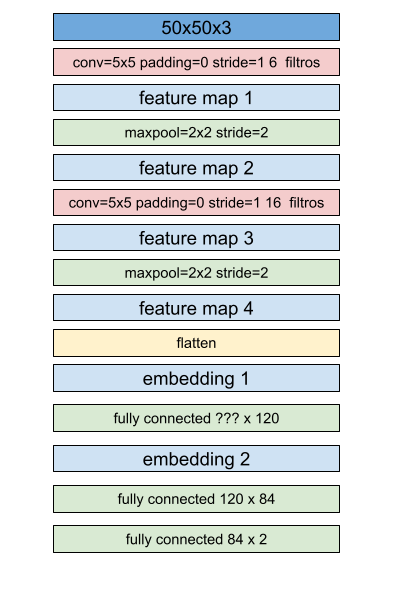

In [5]:
class LeNet(nn.Module):
    def __init__(self):
        super(LeNet,self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3,out_channels=6,kernel_size=5,stride=1,padding=0)
        self.conv2 = nn.Conv2d(in_channels=6,out_channels=16,kernel_size=5,stride=1,padding=0)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2,stride=2,padding=0)
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(1296,120)
        self.fc2 = nn.Linear(120,84)
        self.fc3 = nn.Linear(84,5)

    def forward(self,x):
        x = self.conv1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.conv2(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.relu(x)
        x = self.fc3(x)

        return x


In [6]:
model = LeNet()

In [7]:
model

LeNet(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (relu): ReLU()
  (maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc1): Linear(in_features=1296, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)

In [8]:
x = torch.rand((1,3,50,50))

In [9]:
model(x)

tensor([[-0.0733, -0.0383, -0.0959,  0.0974, -0.0115]],
       grad_fn=<AddmmBackward0>)

In [10]:
import torchsummary

In [11]:
torchsummary.summary(model,(3,50,50),device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 6, 46, 46]             456
              ReLU-2            [-1, 6, 46, 46]               0
         MaxPool2d-3            [-1, 6, 23, 23]               0
            Conv2d-4           [-1, 16, 19, 19]           2,416
              ReLU-5           [-1, 16, 19, 19]               0
         MaxPool2d-6             [-1, 16, 9, 9]               0
           Flatten-7                 [-1, 1296]               0
            Linear-8                  [-1, 120]         155,640
              ReLU-9                  [-1, 120]               0
           Linear-10                   [-1, 84]          10,164
             ReLU-11                   [-1, 84]               0
           Linear-12                    [-1, 5]             425
Total params: 169,101
Trainable params: 169,101
Non-trainable params: 0
-------------------------------

In [ ]:
#model[11] = nn.Linear(84,10)

In [12]:
model

LeNet(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (relu): ReLU()
  (maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc1): Linear(in_features=1296, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=5, bias=True)
)

In [13]:
import torchsummary

In [14]:
x = torch.randn(10,3,50,50)

In [15]:
model = LeNet()


In [16]:
model(x)

tensor([[-0.0881, -0.1288, -0.0078, -0.0804, -0.0687],
        [-0.0766, -0.1090,  0.0064, -0.0827, -0.0726],
        [-0.0761, -0.1196,  0.0010, -0.1053, -0.0791],
        [-0.0975, -0.1032,  0.0065, -0.0872, -0.0791],
        [-0.0557, -0.1164,  0.0067, -0.0806, -0.0652],
        [-0.0827, -0.0993, -0.0038, -0.0926, -0.0682],
        [-0.1003, -0.1044, -0.0251, -0.0955, -0.0505],
        [-0.0805, -0.1245, -0.0170, -0.0889, -0.0708],
        [-0.0866, -0.1106,  0.0299, -0.0794, -0.0588],
        [-0.1042, -0.0943,  0.0050, -0.0775, -0.0642]],
       grad_fn=<AddmmBackward0>)

In [17]:
torchsummary.summary(model,(3,50,50),device='cpu')

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 6, 46, 46]             456
              ReLU-2            [-1, 6, 46, 46]               0
         MaxPool2d-3            [-1, 6, 23, 23]               0
            Conv2d-4           [-1, 16, 19, 19]           2,416
              ReLU-5           [-1, 16, 19, 19]               0
         MaxPool2d-6             [-1, 16, 9, 9]               0
           Flatten-7                 [-1, 1296]               0
            Linear-8                  [-1, 120]         155,640
              ReLU-9                  [-1, 120]               0
           Linear-10                   [-1, 84]          10,164
             ReLU-11                   [-1, 84]               0
           Linear-12                    [-1, 5]             425
Total params: 169,101
Trainable params: 169,101
Non-trainable params: 0
-------------------------------

In [18]:
class LeNet2(nn.Module):
    def __init__(self):
        super(LeNet2,self).__init__()
        self.backbone = nn.Sequential(
            nn.Conv2d(in_channels=3,out_channels=6,kernel_size=5,stride=1,padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2,stride=2,padding=0),
            nn.Conv2d(in_channels=6,out_channels=16,kernel_size=5,stride=1,padding=0),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2,stride=2,padding=0),
            nn.Flatten()
        )
        self.classifier = nn.Sequential(
            nn.Linear(1296,120),
            nn.ReLU(),
            nn.Linear(120,84),
            nn.ReLU(),
            nn.Linear(84,2),
        )


    def forward(self,x):
        x = self.backbone(x)
        x = self.classifier(x)
        return x

In [19]:
model = LeNet2()

In [20]:
model.to('cuda:0')

LeNet2(
  (backbone): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Flatten(start_dim=1, end_dim=-1)
  )
  (classifier): Sequential(
    (0): Linear(in_features=1296, out_features=120, bias=True)
    (1): ReLU()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): ReLU()
    (4): Linear(in_features=84, out_features=2, bias=True)
  )
)

In [21]:
#model.classifier = nn.Sequential(nn.Linear(1296,2))
model.classifier = nn.Sequential(nn.Linear(1296, 2).to('cuda:0')).to('cuda:0')

In [22]:
model

LeNet2(
  (backbone): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Flatten(start_dim=1, end_dim=-1)
  )
  (classifier): Sequential(
    (0): Linear(in_features=1296, out_features=2, bias=True)
  )
)

In [23]:
torchsummary.summary(model,(3,50,50))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 6, 46, 46]             456
              ReLU-2            [-1, 6, 46, 46]               0
         MaxPool2d-3            [-1, 6, 23, 23]               0
            Conv2d-4           [-1, 16, 19, 19]           2,416
              ReLU-5           [-1, 16, 19, 19]               0
         MaxPool2d-6             [-1, 16, 9, 9]               0
           Flatten-7                 [-1, 1296]               0
            Linear-8                    [-1, 2]           2,594
Total params: 5,466
Trainable params: 5,466
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.03
Forward/backward pass size (MB): 0.33
Params size (MB): 0.02
Estimated Total Size (MB): 0.38
----------------------------------------------------------------


In [24]:
model = torchvision.models.mobilenet_v3_large(weights = torchvision.models.MobileNet_V3_Large_Weights.IMAGENET1K_V2)

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-5c1a4163.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-5c1a4163.pth
100%|██████████| 21.1M/21.1M [00:00<00:00, 69.1MB/s]


In [25]:
model = torchvision.models.efficientnet_b0(weights = torchvision.models.EfficientNet_B0_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 157MB/s]


In [26]:
model

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [27]:
#model.classifier[1] = nn.Linear(1280,2)
model.classifier[1] = nn.Linear(in_features=1280, out_features=3)

In [28]:
model

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [29]:
for layer in model.children():
  print(layer)

Sequential(
  (0): Conv2dNormActivation(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU(inplace=True)
  )
  (1): Sequential(
    (0): MBConv(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): SiLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
          (activation): SiLU(inplace=True)
          (scale_activation): Sigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), 

## **Criando o dataset**

In [30]:
def download_images(main_dir,urls_filename):
    class_name = urls_filename.split('.')[-2]
    output_dir = main_dir+os.sep+class_name
    os.makedirs(output_dir,exist_ok=True)
    with open(urls_filename) as f:
        for url in f:
            img_filename = url.split('/')[-1].replace("\n","")
            print(img_filename)
            try:
                response = urllib.request.urlopen(url)
                open(output_dir+'/'+img_filename,mode="wb+").write(response.read())
            except:
                print('nao conseguiu baixar ',url)

In [31]:
!pwd

/content


In [32]:
main_dir = "/content/drive/MyDrive/abobrinhas"

In [33]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [34]:
import os
import csv
from datetime import datetime

# Caminho da pasta principal onde estão as subpastas com fotos
main_folder = '/content/drive/MyDrive/abobrinhas'

# Iterar sobre cada subpasta dentro da pasta principal
for subfolder in os.listdir(main_folder):
    subfolder_path = os.path.join(main_folder, subfolder)

    if os.path.isdir(subfolder_path):  # Verifica se é uma pasta
        # Nome do CSV será o nome da subpasta
        output_csv = f"{subfolder}.csv"

        # Criação do arquivo CSV
        with open(output_csv, mode='w', newline='') as file:
            writer = csv.writer(file)
            writer.writerow(["Nome do Arquivo", "Data de Criação", "Caminho Completo"])

            # Iterar sobre os arquivos na subpasta
            for filename in os.listdir(subfolder_path):
                file_path = os.path.join(subfolder_path, filename)
                if os.path.isfile(file_path):  # Verifica se é um arquivo
                    creation_time = os.path.getctime(file_path)
                    creation_date = datetime.fromtimestamp(creation_time).strftime('%Y-%m-%d %H:%M:%S')

                    # Escrever as informações no arquivo CSV
                    writer.writerow([filename, creation_date, file_path])

        print(f"Arquivo CSV gerado para a subpasta {subfolder}!")



Arquivo CSV gerado para a subpasta abobrinha_brasileira!
Arquivo CSV gerado para a subpasta abobrinha_italiana!
Arquivo CSV gerado para a subpasta abobrinha_paulista!


In [35]:
os.chdir(main_dir)

In [36]:
!ls

abobrinha_brasileira	  abobrinha_italiana	  abobrinha_paulista	  best_model.pth
abobrinha_brasileira.csv  abobrinha_italiana.csv  abobrinha_paulista.csv


In [37]:
download_images(main_dir,'abobrinha_brasileira.csv') #deixa comentado se não faz download +1 vez

Nome do Arquivo,Data de Criação,Caminho Completo
nao conseguiu baixar  Nome do Arquivo,Data de Criação,Caminho Completo

20241023_143036.jpg
nao conseguiu baixar  20241023_143036.jpg,2024-10-25 13:43:44,/content/drive/MyDrive/abobrinhas/abobrinha_brasileira/20241023_143036.jpg

20241023_143040.jpg
nao conseguiu baixar  20241023_143040.jpg,2024-10-25 13:43:52,/content/drive/MyDrive/abobrinhas/abobrinha_brasileira/20241023_143040.jpg

20241023_142920.jpg
nao conseguiu baixar  20241023_142920.jpg,2024-10-25 13:43:59,/content/drive/MyDrive/abobrinhas/abobrinha_brasileira/20241023_142920.jpg

20241023_143057.jpg
nao conseguiu baixar  20241023_143057.jpg,2024-10-25 13:44:06,/content/drive/MyDrive/abobrinhas/abobrinha_brasileira/20241023_143057.jpg

20241023_142925.jpg
nao conseguiu baixar  20241023_142925.jpg,2024-10-25 13:44:12,/content/drive/MyDrive/abobrinhas/abobrinha_brasileira/20241023_142925.jpg

20241023_143111.jpg
nao conseguiu baixar  20241023_143111.jpg,2024-10-25 13:44:19,/conten

In [38]:
import torch
from torchvision import transforms, datasets

transform = transforms.Compose([
    transforms.Resize((256,256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

image_dataset = datasets.ImageFolder(root=main_dir, transform=transform)

In [39]:
x,y = next(iter(image_dataset))

In [40]:
x

tensor([[[ 0.8789,  0.8789,  0.8618,  ...,  0.7419,  0.7591,  0.7762],
         [ 0.8961,  0.8961,  0.8961,  ...,  0.7419,  0.7591,  0.7762],
         [ 0.8789,  0.8961,  0.8961,  ...,  0.7591,  0.7591,  0.7762],
         ...,
         [ 0.8447,  0.8618,  0.8618,  ..., -0.1828, -0.1828, -0.2171],
         [ 0.8789,  0.8789,  0.8789,  ..., -0.1828, -0.1828, -0.1828],
         [ 0.9132,  0.8961,  0.8961,  ..., -0.1657, -0.1657, -0.1828]],

        [[ 0.9230,  0.9230,  0.9055,  ..., -0.8803, -0.8627, -0.8627],
         [ 0.9055,  0.9055,  0.9055,  ..., -0.8627, -0.8627, -0.8627],
         [ 0.8880,  0.8880,  0.8880,  ..., -0.8627, -0.8627, -0.8452],
         ...,
         [-0.9853, -0.9678, -0.9503,  ..., -0.7402, -0.7402, -0.7752],
         [-0.9153, -0.8978, -0.8978,  ..., -0.6877, -0.7052, -0.7402],
         [-0.8452, -0.8452, -0.8277,  ..., -0.6702, -0.6877, -0.7227]],

        [[ 1.1411,  1.1411,  1.1237,  ..., -0.5147, -0.4973, -0.4973],
         [ 1.1237,  1.1411,  1.1411,  ..., -0

In [41]:
y

0

In [42]:
dir(image_dataset)

['__add__',
 '__annotations__',
 '__class__',
 '__class_getitem__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__orig_bases__',
 '__parameters__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_format_transform_repr',
 '_is_protocol',
 '_repr_indent',
 'class_to_idx',
 'classes',
 'extensions',
 'extra_repr',
 'find_classes',
 'imgs',
 'loader',
 'make_dataset',
 'root',
 'samples',
 'target_transform',
 'targets',
 'transform',
 'transforms']

In [43]:
#para ver as classes
image_dataset.classes

['abobrinha_brasileira', 'abobrinha_italiana', 'abobrinha_paulista']

In [44]:
#para ver como será classificada as imagens
image_dataset.class_to_idx

{'abobrinha_brasileira': 0, 'abobrinha_italiana': 1, 'abobrinha_paulista': 2}

In [45]:
image_dataset.targets[0]

0

In [46]:
image_dataset[0]

(tensor([[[ 0.8789,  0.8789,  0.8618,  ...,  0.7419,  0.7591,  0.7762],
          [ 0.8961,  0.8961,  0.8961,  ...,  0.7419,  0.7591,  0.7762],
          [ 0.8789,  0.8961,  0.8961,  ...,  0.7591,  0.7591,  0.7762],
          ...,
          [ 0.8447,  0.8618,  0.8618,  ..., -0.1828, -0.1828, -0.2171],
          [ 0.8789,  0.8789,  0.8789,  ..., -0.1828, -0.1828, -0.1828],
          [ 0.9132,  0.8961,  0.8961,  ..., -0.1657, -0.1657, -0.1828]],
 
         [[ 0.9230,  0.9230,  0.9055,  ..., -0.8803, -0.8627, -0.8627],
          [ 0.9055,  0.9055,  0.9055,  ..., -0.8627, -0.8627, -0.8627],
          [ 0.8880,  0.8880,  0.8880,  ..., -0.8627, -0.8627, -0.8452],
          ...,
          [-0.9853, -0.9678, -0.9503,  ..., -0.7402, -0.7402, -0.7752],
          [-0.9153, -0.8978, -0.8978,  ..., -0.6877, -0.7052, -0.7402],
          [-0.8452, -0.8452, -0.8277,  ..., -0.6702, -0.6877, -0.7227]],
 
         [[ 1.1411,  1.1411,  1.1237,  ..., -0.5147, -0.4973, -0.4973],
          [ 1.1237,  1.1411,

In [ ]:
#download_images(main_dir,'abobrinha_brasileira.csv')
#download_images(main_dir,'abobrinha_italiana.csv')
#download_images(main_dir,'abobrinha_paulista.csv')

In [47]:
device = torch.device('cuda:0')
model.to(device)

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

# construção do loader

In [48]:
def image_loader(img):
    return Image.open(img).convert("RGB")

In [49]:
img = image_loader('./abobrinha_paulista/20241023_142746.jpg')

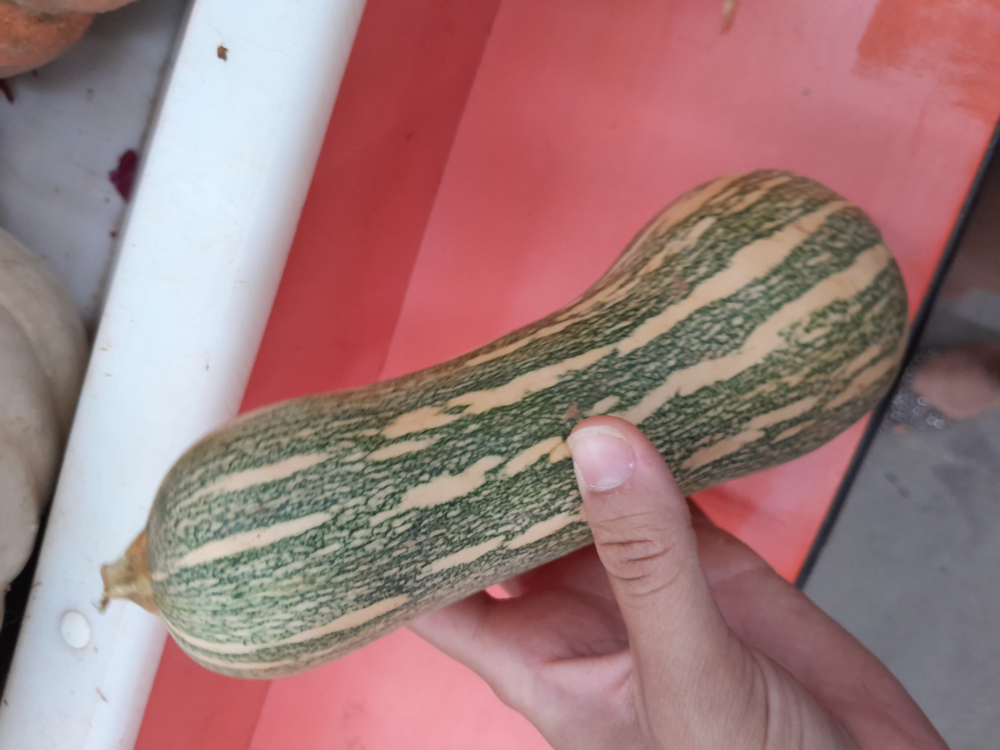

In [50]:
img

In [51]:
tconvert = transforms.Resize((255,255))

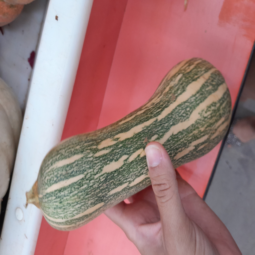

In [52]:
tconvert(img)

In [53]:
tconvert2 = transforms.CenterCrop((227,227))

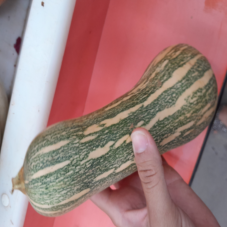

In [54]:
tconvert2(tconvert(img))

In [55]:
img_tensor = transform(img)

In [56]:
img_tensor

tensor([[[ 0.0056, -0.1657, -0.2513,  ...,  1.2214,  1.2043,  1.2385],
         [ 0.2624,  0.1426, -0.0116,  ...,  1.2728,  1.2214,  1.2214],
         [ 0.5707,  0.4679,  0.3138,  ...,  1.3070,  1.2728,  1.2557],
         ...,
         [ 0.8618,  0.9474,  1.0331,  ..., -0.0801, -0.0629, -0.0458],
         [ 0.8789,  0.9474,  1.0331,  ..., -0.0801, -0.0629, -0.0629],
         [ 0.8961,  0.9817,  1.0673,  ..., -0.0629, -0.0629, -0.0972]],

        [[-0.5476, -0.6001, -0.6352,  ..., -0.2850, -0.3025, -0.3025],
         [-0.4426, -0.4601, -0.5651,  ..., -0.2150, -0.2850, -0.3375],
         [-0.3725, -0.4251, -0.5126,  ..., -0.1099, -0.2325, -0.3200],
         ...,
         [ 1.0805,  1.1506,  1.2556,  ...,  0.0301,  0.0476,  0.0651],
         [ 1.0805,  1.1681,  1.2556,  ...,  0.0301,  0.0476,  0.0301],
         [ 1.0980,  1.2031,  1.2906,  ...,  0.0476,  0.0301, -0.0049]],

        [[-0.7587, -0.7587, -0.7936,  ..., -0.1312, -0.1312, -0.1835],
         [-0.6018, -0.6193, -0.6890,  ..., -0

In [57]:
img_tensor.shape

torch.Size([3, 256, 256])

# Construçãoda classe dataset

In [58]:
dataset = image_dataset

In [59]:
len(dataset)

647

In [60]:
np.unique(dataset.targets,return_counts=True)

(array([0, 1, 2]), array([224, 214, 209]))

In [61]:
dataset.targets = torch.tensor(dataset.targets)

# Treinamento da rede

In [62]:
ds = image_dataset

In [63]:
from sklearn.model_selection import train_test_split

In [64]:
np.unique(ds.targets, return_counts=True)

(array([0, 1, 2]), array([224, 214, 209]))

In [65]:
ds

Dataset ImageFolder
    Number of datapoints: 647
    Root location: /content/drive/MyDrive/abobrinhas
    StandardTransform
Transform: Compose(
               Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )

In [66]:
ds.targets = np.array(ds.targets)

In [67]:
bs = 64
train_idx, temp_idx = train_test_split(np.arange(len(ds)),test_size=0.3,shuffle=True,stratify=ds.targets)
valid_idx, test_idx = train_test_split(temp_idx,test_size=0.5,shuffle=True,stratify=ds.targets[temp_idx])

train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)
test_sampler  = torch.utils.data.SubsetRandomSampler(test_idx)

dl_train = torch.utils.data.DataLoader(ds,batch_size=bs,sampler=train_sampler)
dl_valid = torch.utils.data.DataLoader(ds,batch_size=bs,sampler=valid_sampler)
dl_test  = torch.utils.data.DataLoader(ds,batch_size=bs,sampler=test_sampler)

In [68]:
np.unique(ds.targets[train_idx], return_counts=True)

(array([0, 1, 2]), array([156, 150, 146]))

In [69]:
np.unique(ds.targets[valid_idx], return_counts=True)

(array([0, 1, 2]), array([34, 32, 31]))

In [70]:
np.unique(ds.targets[test_idx], return_counts=True)

(array([0, 1, 2]), array([34, 32, 32]))

In [71]:
x,y = next(iter(dl_train))

In [72]:
x.shape, y.shape

(torch.Size([64, 3, 256, 256]), torch.Size([64]))

In [73]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

In [74]:
device

device(type='cuda', index=0)

In [75]:
torch.cuda.get_device_properties(0)

_CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15102MB, multi_processor_count=40, uuid=bf8524c6-ccf5-828c-74ed-58231447c1e7, L2_cache_size=4MB)

In [76]:
x.to(device)

tensor([[[[ 0.6049,  0.6221,  0.6563,  ...,  1.5468,  1.5468,  1.5297],
          [ 0.6392,  0.6392,  0.6392,  ...,  1.5639,  1.5639,  1.5639],
          [ 0.6049,  0.6392,  0.6221,  ...,  1.5810,  1.5639,  1.5639],
          ...,
          [-0.3541, -0.4568, -0.6623,  ...,  1.1700,  1.1700,  1.1700],
          [-0.2513, -0.2513, -0.2342,  ...,  1.1700,  1.1700,  1.1529],
          [-0.2856, -0.2684, -0.2513,  ...,  1.1529,  1.1529,  1.1529]],

         [[-0.9153, -0.7402, -0.6001,  ...,  0.2052,  0.2052,  0.1877],
          [-0.8102, -0.6877, -0.6001,  ...,  0.2227,  0.2227,  0.2227],
          [-0.7577, -0.6527, -0.6001,  ...,  0.2227,  0.2227,  0.2227],
          ...,
          [-0.2675, -0.3725, -0.5476,  ..., -0.4601, -0.4601, -0.4601],
          [-0.1800, -0.1800, -0.1625,  ..., -0.4601, -0.4601, -0.4776],
          [-0.2150, -0.1975, -0.1800,  ..., -0.4776, -0.4776, -0.4776]],

         [[-0.4798, -0.2881, -0.1487,  ...,  0.4788,  0.4788,  0.4614],
          [-0.3927, -0.2532, -

In [77]:
model

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [78]:
model.to(device)

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [79]:
loss_train = []
loss_eval = []

In [80]:
patience_time = 15

In [81]:
criterion = nn.CrossEntropyLoss()
opt = optim.SGD(model.parameters(),lr=0.01)

In [82]:
epochs = 30
stop = False
epoch = 0
lowest_loss_eval = 10000
last_best_result = 0

while (not stop):
    model.train()
    lloss = []
    for x,y in dl_train:
        x = x.to(device)
        y = y.to(device)
        pred = model(x)
        closs = criterion(pred,y)
        closs.backward()
        opt.step()
        opt.zero_grad()
        lloss.append(closs.item())
        #print(closs.item())
    loss_train.append(np.mean(lloss))
    lloss = []
    model.eval()
    lres = []
    ytrue = []

    with torch.no_grad():
        for data,y in dl_valid:
            data = data.to(device)

            pred = model(data)
            closs = criterion(pred.cpu(),y)
            lloss.append(closs.item())
            res  = pred.argmax(dim=1).cpu().tolist()
            lres += res
            ytrue += y
    avg_loss_eval = np.mean(lloss)
    loss_eval.append(avg_loss_eval)
    #wandb.log({"loss_eval": avg_loss_eval,"loss_train":loss_train[-1]})

    if avg_loss_eval < lowest_loss_eval:
        lowest_loss_eval = avg_loss_eval
        last_best_result = 0
        print("Best model found! saving...")
        actual_state = {'optim':opt.state_dict(),'model':model.state_dict(),'epoch':epoch,'loss_train':loss_train,'loss_eval':loss_eval}
        torch.save(actual_state,'best_model.pth')
    last_best_result += 1
    if last_best_result > patience_time:
      stop = True
    print("epoch %d loss_train %4.3f loss_eval %4.3f last_best %d"%(epoch,loss_train[-1],loss_eval[-1],last_best_result))
    epoch += 1

Best model found! saving...
epoch 0 loss_train 1.053 loss_eval 0.892 last_best 1
Best model found! saving...
epoch 1 loss_train 0.922 loss_eval 0.737 last_best 1
Best model found! saving...
epoch 2 loss_train 0.821 loss_eval 0.675 last_best 1
Best model found! saving...
epoch 3 loss_train 0.666 loss_eval 0.549 last_best 1
Best model found! saving...
epoch 4 loss_train 0.619 loss_eval 0.457 last_best 1
Best model found! saving...
epoch 5 loss_train 0.555 loss_eval 0.402 last_best 1
Best model found! saving...
epoch 6 loss_train 0.408 loss_eval 0.337 last_best 1
Best model found! saving...
epoch 7 loss_train 0.337 loss_eval 0.279 last_best 1
Best model found! saving...
epoch 8 loss_train 0.305 loss_eval 0.231 last_best 1


KeyboardInterrupt: 

In [83]:
recover = torch.load('best_model.pth')

<ipython-input-83-07b60b9afd24>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  recover = torch.load('best_model.pth')


In [84]:
opt.load_state_dict(recover['optim'])
model.load_state_dict(recover['model'])
loss_train = recover['loss_train']
loss_eval = recover['loss_eval']
epoch = recover['epoch']

In [85]:
l = []
for layer in model.children():
  l.append(layer)

In [86]:
model

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [87]:
x = torch.randn(1, 3, 448, 448).to('cuda:0')
model(x)

tensor([[-0.0011,  0.1118,  0.0778]], device='cuda:0',
       grad_fn=<AddmmBackward0>)

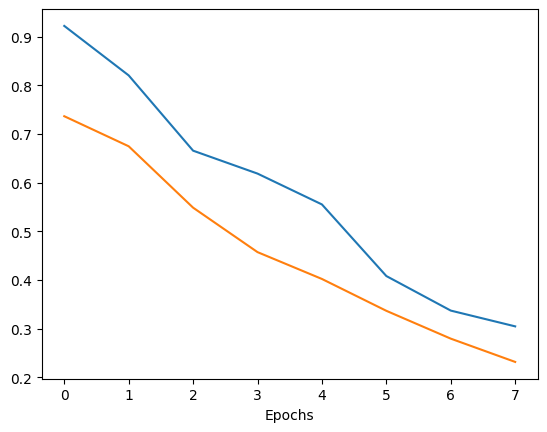

In [88]:
#gráfico
import matplotlib.pyplot as plt

fig = plt.figure()
plt.plot(loss_train[1:])
plt.plot(loss_eval[1:])
plt.xlabel('Epochs')
plt.show()

In [89]:
import sklearn.metrics as metrics
model.to(device)

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [90]:
model.eval()
lres = []
ytrue = []
with torch.no_grad():
    for data,target in dl_test:
        data = data.to(device)
        pred = model(data)
        res  = pred.argmax(dim=1).cpu().tolist()
        lres += res
        ytrue += target

In [91]:
#matriz
metrics.confusion_matrix(ytrue,lres)

array([[34,  0,  0],
       [ 1, 31,  0],
       [ 0,  1, 31]])

In [92]:
#acuracia
metrics.accuracy_score(ytrue,lres)

0.9795918367346939

In [94]:
metrics.precision_score(ytrue,lres, average='weighted')

0.9798833819241982

In [96]:
metrics.recall_score(ytrue,lres, average='weighted')

0.9795918367346939

In [98]:
metrics.f1_score(ytrue,lres, average='weighted')

0.9795847945803581

In [99]:
print(metrics.classification_report(ytrue,lres))

              precision    recall  f1-score   support

           0       0.97      1.00      0.99        34
           1       0.97      0.97      0.97        32
           2       1.00      0.97      0.98        32

    accuracy                           0.98        98
   macro avg       0.98      0.98      0.98        98
weighted avg       0.98      0.98      0.98        98



# Vizualização das imagems e predição

In [100]:
image_loader = lambda x: Image.open(x).convert('RGB')

In [101]:
img = image_loader('./abobrinha_paulista/20241023_142748.jpg')

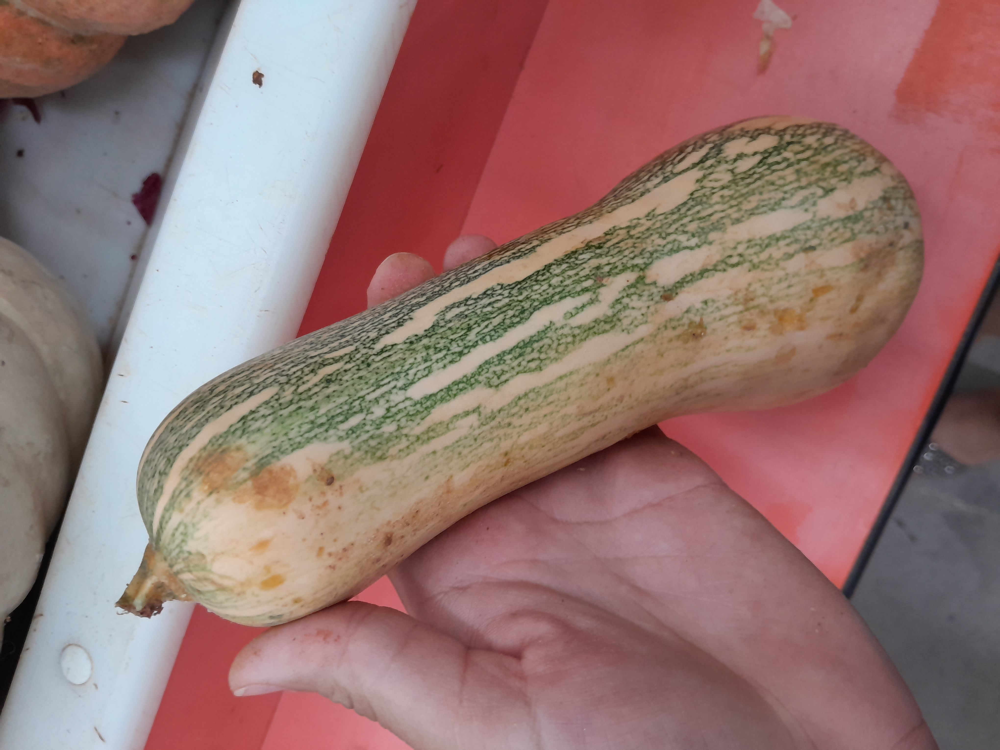

In [102]:
img

In [103]:
x = transform(img)

In [104]:
x.shape

torch.Size([3, 256, 256])

In [105]:
x = x.to(device)

In [107]:
# Add a batch dimension to the input tensor 'x' before passing it to the model
x = x.unsqueeze(0)

In [108]:
pred = model(x)

In [109]:
pred

tensor([[-1.2681,  0.5874,  0.8718]], device='cuda:0',
       grad_fn=<AddmmBackward0>)